In [1]:
# Necessary imports
import nltk, re, pandas as pd, xml, os, sklearn, string, numpy as np, time, pickle, gc as gc, warnings
import seaborn as sns, matplotlib.pyplot as plt, plotly.express as px, plotly.offline as plotly_offline
from nltk.corpus import stopwords
from bs4 import BeautifulSoup
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.model_selection import train_test_split, cross_validate, StratifiedShuffleSplit, cross_val_score
from sklearn.naive_bayes import GaussianNB, MultinomialNB, ComplementNB, BernoulliNB
from nltk.stem.snowball import SnowballStemmer

from research_utils import *

# Other settings
gc.enable()
warnings.filterwarnings("ignore")
plotly_offline.init_notebook_mode(connected = True)

In [11]:
# Normality Test Imports
from statsmodels.graphics.gofplots import qqplot
from matplotlib import pyplot
from scipy.stats import shapiro, normaltest, anderson

In [ ]:
# Function to plot qq plots for every column in a dataframe
def df_qq_plot(data):
    for col in data.columns:
        qqplot(data[col].to_numpy(), line='s')
        pyplot.show()

# Function to determine % of columns in dataset that are potentially normally distributed
# According to Shapiro-Wilk
def shapiro_wilk(data, alpha, avg):
    # Counts for the # of columns that reject the null hypothesis
    count_true = 0
    count_false = 0
    
    # If you want averages returned, create lists for that
    if avg:
        ps = []
        stats = []
    
    # Loop through all the columns
    for col in data.columns:
        # Run the shapiro test
        stat, p = shapiro(data[col].to_numpy())
        # If you want the averages
        if avg:
            # Append those
            ps.append(p)
            stats.append(stat)
        
        # If p is greater than the alpha value passed
        if p > alpha:
            # It is true
            count_true += 1
        # Otherwise
        else:
            # It is false
            count_false += 1
    
    # If you want the averages, return the % of Gaussian columns and the averages
    if avg:
        return 100 * (count_true / (count_true+count_false)), np.average(np.asarray(ps)), np.average(np.asarray(stats))
    # Otherwise, just return the % of Gaussian columns
    else:
        return 100 * (count_true / (count_true+count_false))

# Function to determine % of columns in dataset that are potentially normally distributed
# According to Dagastino K^2
def dagastino(data, alpha, avg):
    # Counts for the # of columns that reject the null hypothesis
    count_true = 0
    count_false = 0
    
    # If you want averages returned, create lists for that
    if avg:
        ps = []
        stats = []
    
    # Loop through all the columns
    for col in data.columns:
        # Run the shapiro test
        stat, p = shapiro(data[col].to_numpy())
        # If you want the averages
        if avg:
            # Append those
            ps.append(p)
            stats.append(stat)
        
        # If p is greater than the alpha value passed
        if p > alpha:
            # It is true
            count_true += 1
        # Otherwise
        else:
            # It is false
            count_false += 1
    
    # If you want the averages, return the % of Gaussian columns and the averages
    if avg:
        return 100 * (count_true / (count_true+count_false)), np.average(np.asarray(ps)), np.average(np.asarray(stats))
    # Otherwise, just return the % of Gaussian columns
    else:
        return 100 * (count_true / (count_true+count_false))

# Function to determine % of columns in dataset that are potentially normally distributed
# According to the Anderson-Darling Test
def anderson(data, avg):
    # Counts for the # of columns that reject the null hypothesis
    count_true = 0
    count_false = 0

    # If you want averages returned, create lists for that
    if avg:
        sig_levels = []
        crit_values = []
    
    # Loop through all the columns
    for col in data.columns:
        # Collect the results from the anderson-darling test
        result = anderson(data[col].to_numpy())
        # Loop through the critical values
        for i in range(len(result.critical_values)):
            # Grab the significance level and critical value
            sl, cv = result.significance_level[i], result.critical_values[i]
            
            # If you want averages, append them
            if avg:
                sig_levels.append(results.significance_level[i])
                crit_values.append(result.critical_values[i])
            
            # If the stat is less than the critical value, it is normally distributed
            if result.statistic < result.critical_values[i]:
                count_true += 1
            # Otherwise, it is not
            else:
                count_false += 1    
                    
    # If you want averages, return that
    if avg:
        return 100 * (count_true / (count_true+count_false)), np.average(np.asarray(sig_levels)), np.average(np.asarray(crit_values))
    # Otherwise, just return the % of columns
    else:
        return 100 * (count_true / (count_true+count_false))

In [4]:
dfs, names, classes = load_imdb_data()

boolean = dfs[0]
tfidf = dfs[1]
freq = dfs[2]

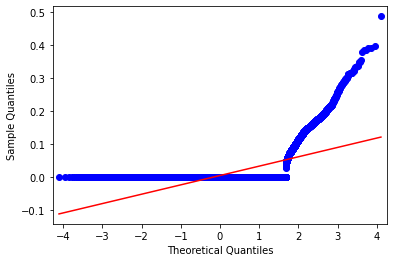

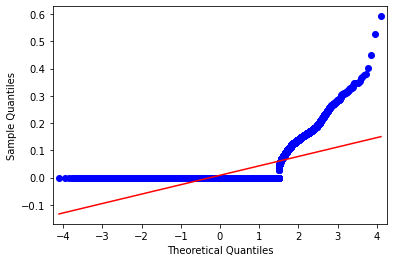

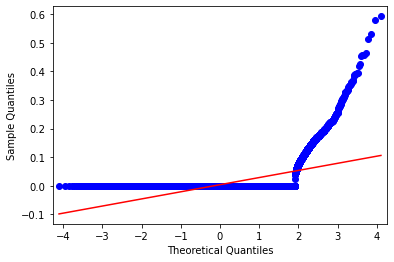

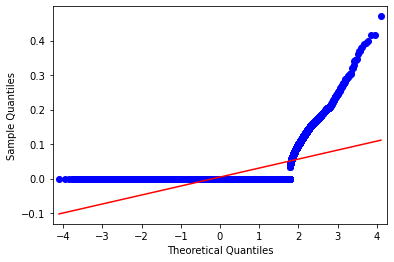

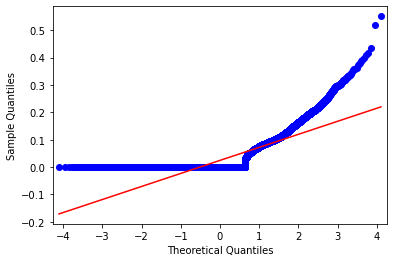

...

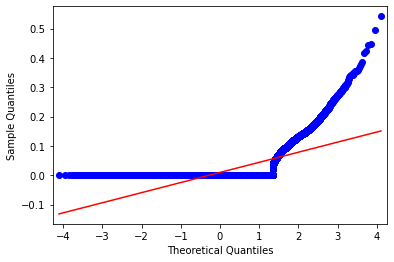

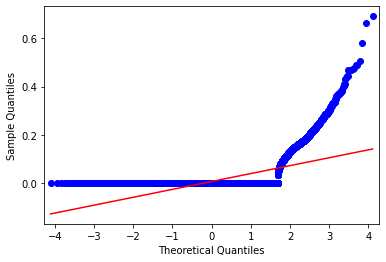

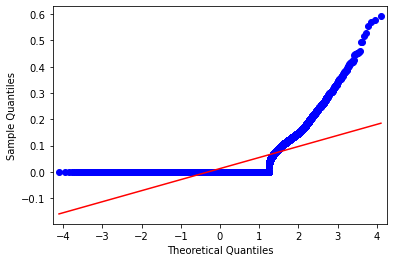

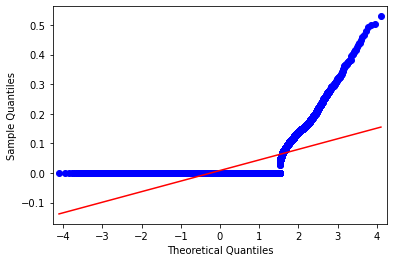

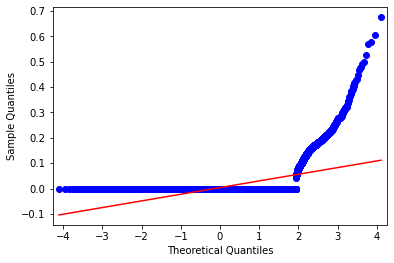

In [5]:
# Initial Looks at QQ Plots in TFIDF

for col in tfidf.columns:
    qqplot(tfidf[col].to_numpy(), line='s')
    pyplot.show()

In [7]:
# Shapiro-Wilk Test

alpha = 0.05
count_true = 0
count_false = 0

for col in tfidf.columns:
    stat, p = shapiro(tfidf[col].to_numpy())
    if p > alpha:
        count_true += 1
    else:
        count_false += 1

print("{}% of columns are normally distributed according to the Shapiro-Wilk Test".format(100 * (count_true / (count_true+count_false))))

0.0% of columns are normally distributed


In [14]:
# D'Agostino's K^2 Test

alpha = 0.05
count_true = 0
count_false = 0

for col in tfidf.columns:
    stat, p = normaltest(tfidf[col].to_numpy())
    if p > alpha:
        count_true += 1
    else:
        count_false += 1
        
print("{}% of columns are normally distributed according to the D'Agostino's K^2 Test".format(100 * (count_true / (count_true+count_false))))        

0.0% of columns are normally distributed


In [16]:
# Anderson-Darling Test

alpha = 0.05
count_true = 0
count_false = 0

for col in tfidf.columns:
    result = anderson(tfidf[col].to_numpy())
    for i in range(len(result.critical_values)):
        sl, cv = result.significance_level[i], result.critical_values[i]
        if result.statistic < result.critical_values[i]:
            count_true += 1
        else:
            count_false += 1
            
print("{}% of columns are normally distributed according to the Anderson-Darling Test".format(100 * (count_true / (count_true+count_false))))                    

0.0% of columns are normally distributed


In [17]:
# Get fresh data
new_dfs, new_names, new_classes = load_imdb_data()

In [18]:
# Replace -1 with 1, 1 with 3
new_classes.replace(1,3, inplace=True)
new_classes.replace(-1,1, inplace=True)

# Change floats to ints
new_classes = [int(x) for x in list(new_classes)]

In [19]:
# Make sure it is binary
assert(len(list(set(new_classes))) == 2)
# Confirm the classes are 3 and 1
print(set(new_classes))

{1, 3}


In [21]:
# Loop through the scaled dfs
for df in new_dfs:
    df['classification'] = new_classes
    # Multiply the values by *-1 if the sentiment was negative
    df.update(df.drop('classification',axis=1).mul(df.classification,axis=0)[df.classification.eq(3)])
    # Drop the classification column now
    df.drop('classification', inplace=True, axis=1)
    # Free up some memory
    gc.collect()

In [22]:
new_boolean = new_dfs[0]
new_tfidf = new_dfs[1]
new_freq = new_dfs[2]

In [25]:
# Visual Check that the data is scaled
scaled = new_tfidf['move'].to_numpy()
unscaled = tfidf['move'].to_numpy()

for i in range(len(scaled)):
    print("Unscaled: {} | Scaled: {}".format(unscaled[i], scaled[i]))

Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.10877959312605948 | Scaled: 0.10877959312605948
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.12398576290147564 | Scaled: 0.12398576290147564
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.1597891360635546 | Scaled: 0.1597891360635546
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 

Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.16621565468947286 | Scaled: 0.16621565468947286
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.1528002913199117 | Scaled: 0.1528002913199117
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.08685782244713447 | Scaled: 0.08685782244713447
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 

Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.11522313658681672 | Scaled: 0.11522313658681672
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.06061501092090901 | Scaled: 0.06061501092090901
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.

Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.08147053559005897 | Scaled: 0.08147053559005897
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.06454642679424417 | Scaled: 0.06454642679424417
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.07886262377056259 | Scaled: 0.07886262377056259
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled

Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.10336239555133428 | Scaled: 0.10336239555133428
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.11819759943743455 | Scaled: 0.11819759943743455
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.07798653139277402 | Scaled: 0.07798653139277402
Unscaled: 0.11185046366929367 | Scaled: 0.11185046366929367
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.1285445738380185 | Scaled: 0.1285445738380185
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Un

Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.10184977705136004 | Scaled: 0.10184977705136004
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.10070628208064332 | Scaled: 0.10070628208064332
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.12707493021814842 | Scaled: 0.12707493021814842
Unscaled

Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.10705097578860967 | Scaled: 0.963458782097487
Unscaled: 0.13564013119797275 | Scaled: 1.2207611807817547
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.088

Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.1407069136310099 | Scaled: 1.2663622226790892
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.1814460303588518 | Scaled: 1.6330142732296662
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.17284386060548174 | Scaled: 1.5555947454493357
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0

Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.08158104589993545 | Scaled: 0.734229413099419
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Sc

Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.03713457831175064 | Scaled: 0.3342112048057558
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.03948113821635625 | Scaled: 0.35533024394720625
Unscaled: 0.14219357417325856 | Scaled: 1.279742167559327
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0

Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.17165528079854955 | Scaled: 1.544897527186946
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0778940090876302 | Scaled: 0.7010460817886718
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.0 | Scaled: 0.0
Unscaled: 0.2339990372711339 | Scaled: 2.105

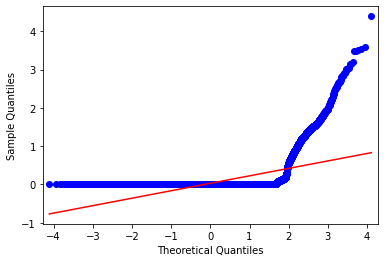

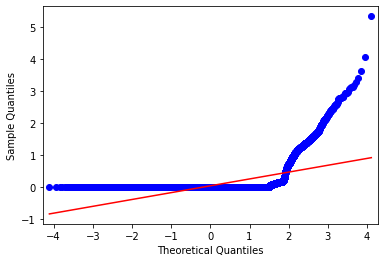

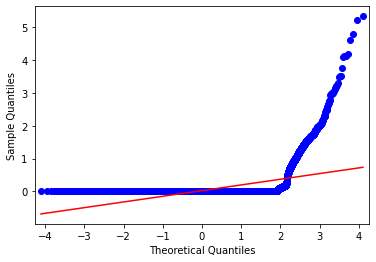

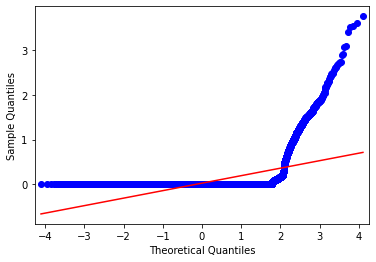

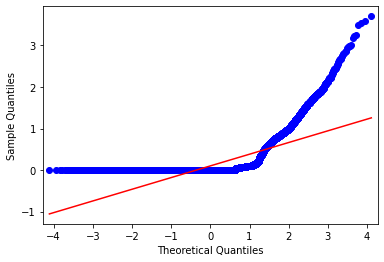

...

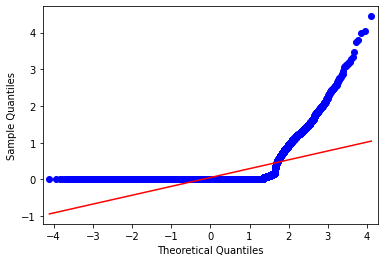

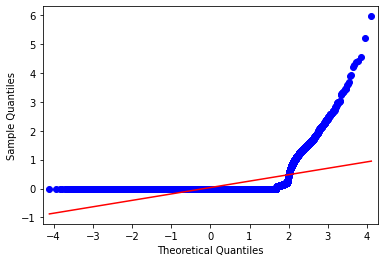

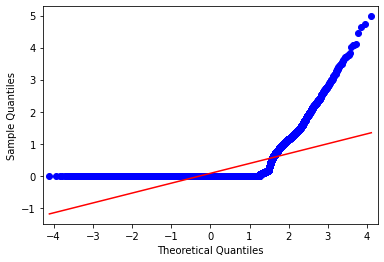

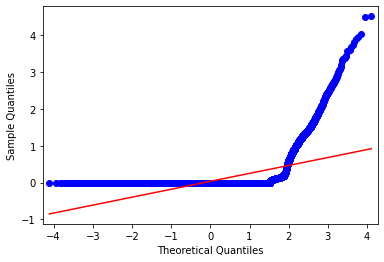

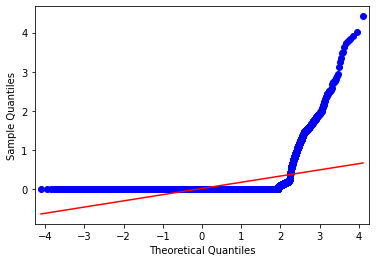

In [26]:
# Initial Looks at QQ Plots in TFIDF

for col in new_tfidf.columns:
    qqplot(new_tfidf[col].to_numpy(), line='s')
    pyplot.show()

In [29]:
# Shapiro-Wilk Test

alpha = 0.05
count_true = 0
count_false = 0

for col in new_tfidf.columns:
    stat, p = shapiro(new_tfidf[col].to_numpy())
    if p > alpha:
        count_true += 1
    else:
        count_false += 1

print("{}% of columns are normally distributed according to the Shapiro-Wilk Test".format(100 * (count_true / (count_true+count_false))))

0.0% of columns are normally distributed according to the Shapiro-Wilk Test


In [30]:
# D'Agostino's K^2 Test

alpha = 0.05
count_true = 0
count_false = 0

for col in new_tfidf.columns:
    stat, p = normaltest(new_tfidf[col].to_numpy())
    if p > alpha:
        count_true += 1
    else:
        count_false += 1
        
print("{}% of columns are normally distributed according to the D'Agostino's K^2 Test".format(100 * (count_true / (count_true+count_false))))        

0.0% of columns are normally distributed according to the D'Agostino's K^2 Test


In [31]:
# Anderson-Darling Test

alpha = 0.05
count_true = 0
count_false = 0

for col in new_tfidf.columns:
    result = anderson(new_tfidf[col].to_numpy())
    for i in range(len(result.critical_values)):
        sl, cv = result.significance_level[i], result.critical_values[i]
        if result.statistic < result.critical_values[i]:
            count_true += 1
        else:
            count_false += 1
            
print("{}% of columns are normally distributed according to the Anderson-Darling Test".format(100 * (count_true / (count_true+count_false))))                    

0.0% of columns are normally distributed according to the Anderson-Darling Test
